https://huggingface.co/learn/cookbook/stable_diffusion_interpolation (ref)

In [ ]:
!pip install -q diffusers transformers xformers accelerate
!pip install -q numpy scipy ftfy Pillow diffusers

In [15]:
from diffusers import StableDiffusionPipeline
from transformers import logging
import torch
import time
from PIL import Image
from diffusers import (
    DDIMScheduler,
    LMSDiscreteScheduler
    )

In [55]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [56]:
torch.backends.cudnn.benchmark = True
torch.backends.cuda.matmul.allow_tf32 = True

In [57]:
model_name_or_path = 'runwayml/stable-diffusion-v1-5'

In [58]:
scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule='scaled_linear', num_train_timesteps=1000)

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained(model_name_or_path,
                                                 scheduler=scheduler, torch_dtype=torch.float32).to(device)

In [60]:
pipe.set_progress_bar_config(disable=True)

In [61]:
# Offloading the weights to the CPU and only loading them on the GPU can reduce memory consumption to less than 3GB.
pipe.enable_model_cpu_offload()

# Tighter ordering of memory tensors.
pipe.unet.to(memory_format=torch.channels_last)

# Decoding large batches of images with limited VRAM or batches with 32 images or more by decoding the batches of latents one image at a time.
pipe.enable_vae_slicing()

# Splitting the image into overlapping tiles, decoding the tiles, and then blending the outputs together to compose the final image.
pipe.enable_vae_tiling()

# Using Flash Attention; If you have PyTorch >= 2.0 installed, you should not expect a speed-up for inference when enabling xformers.
pipe.enable_xformers_memory_efficient_attention()

In [62]:
import numpy as np
import IPython as ipy
import os
from tqdm import tqdm

In [74]:
def display_image(images,save_path):
  try:
    images = [Image.fromarray(np.array(image[0], dtype=np.uint8)) for image in images]
    filename = time.strftime("%H:%M:%S", time.localtime()).replace(":", "-")
    images[0].save(
        f"{save_path}/{filename}.gif",
        save_all=True,
        append_images=images[1:],
        duration=100,
        loop=0
    )

  except Exception as e :
    print(e)

  return ipy.display.Image(f"{save_path}/{filename}.gif")


In [64]:
# The seed is set to "None", because we want different results each time we run the generation.
seed = None

if seed is not None:
    generator = torch.manual_seed(seed)
else:
    generator = None

# The guidance scale is set to its normal range (7 - 10).
guidance_scale = 8

# The number of inference steps was chosen empirically to generate an acceptable picture within an acceptable time.
num_inference_steps = 15

# The higher you set this value, the smoother the interpolations will be. However, the generation time will increase. This value was chosen empirically.
num_interpolation_steps = 30

# I would not recommend less than 512 on either dimension. This is because this model was trained on 512x512 image resolution.
height = 512
width = 512

# The path where the generated GIFs will be saved
save_path = "/output"

if not os.path.exists(save_path):
    os.makedirs(save_path)

In [65]:
# The text prompt that describes the desired output image.
prompt = "Epic shot of Sweden, ultra detailed lake with an ren dear, nostalgic vintage, ultra cozy and inviting, wonderful light atmosphere, fairy, little photorealistic, digital painting, sharp focus, ultra cozy and inviting, wish to be there. very detailed, arty, should rank high on youtube for a dream trip."
# A negative prompt that can be used to steer the generation away from certain features; here, it is empty.
negative_prompt = "poorly drawn,cartoon, 2d, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry"


In [66]:
step_size = 0.001

prompt_tokens = pipe.tokenizer(prompt,
                               padding='max_length', max_length=pipe.tokenizer.model_max_length,
                               truncation=True, return_tensors='pt')
prompt_embeds = pipe.text_encoder(prompt_tokens.input_ids.to(device))[0]

In [67]:
if negative_prompt is None:
    negative_prompt = [""]

negative_prompt_tokens = pipe.tokenizer(
    negative_prompt,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
negative_prompt_embeds = pipe.text_encoder(negative_prompt_tokens.input_ids.to(device))[0]

In [68]:
latents = torch.randn(
    (1, pipe.unet.config.in_channels, height//8, width//8),
    generator=generator,
)

In [69]:
walked_embeddings = []
for i in range(num_interpolation_steps):
  walked_embeddings.append([prompt_embeds+ step_size*i, negative_prompt_embeds+ step_size*i])

In [70]:
images = []
for latent in tqdm(walked_embeddings):
  images.append(
      pipe(
          height=height,
          width=width,
          num_images_per_prompt=1,
          prompt_embeds=latent[0],
          negative_prompt_embeds=latent[1],
          num_inference_steps=num_inference_steps,
          guidance_scale=guidance_scale,
          generator=generator,
          latents=latents
      ).images
  )

100%|██████████| 30/30 [05:23<00:00, 10.78s/it]


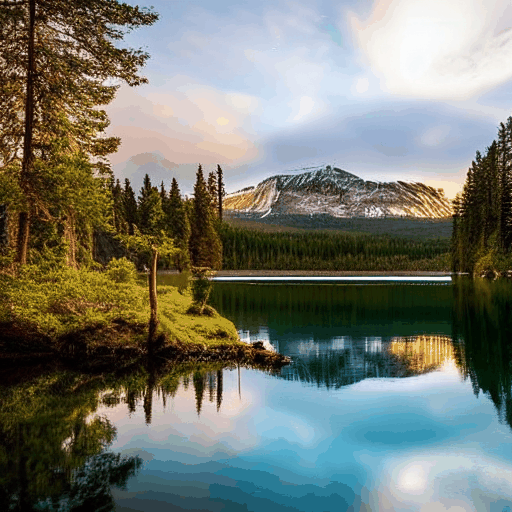

In [75]:
display_image(images, save_path)

In [76]:
def slerp(v0, v1, num, t0=0, t1=1):
    v0 = v0.detach().cpu().numpy()
    v1 = v1.detach().cpu().numpy()

    def interpolation(t, v0, v1, DOT_THRESHOLD=0.9995):
        """helper function to spherically interpolate two arrays v1 v2"""
        dot = np.sum(v0 * v1 / (np.linalg.norm(v0) * np.linalg.norm(v1)))
        if np.abs(dot) > DOT_THRESHOLD:
            v2 = (1 - t) * v0 + t * v1
        else:
            theta_0 = np.arccos(dot)
            sin_theta_0 = np.sin(theta_0)
            theta_t = theta_0 * t
            sin_theta_t = np.sin(theta_t)
            s0 = np.sin(theta_0 - theta_t) / sin_theta_0
            s1 = sin_theta_t / sin_theta_0
            v2 = s0 * v0 + s1 * v1
        return v2

    t = np.linspace(t0, t1, num)

    v3 = torch.tensor(np.array([interpolation(t[i], v0, v1) for i in range(num)]))

    return v3

In [77]:
# The text prompt that describes the desired output image.
prompt = (
    "Sci-fi digital painting of an alien landscape with otherworldly plants, strange creatures, and distant planets."
)
# A negative prompt that can be used to steer the generation away from certain features.
negative_prompt = "poorly drawn,cartoon, 3d, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry"

# Generating initial latent vectors from a random normal distribution. In this example two latent vectors are generated, which will serve as start and end points for the interpolation.
# These vectors are shaped to fit the input requirements of the diffusion model's U-Net architecture.
latents = torch.randn(
    (2, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)

# Getting our latent embeddings
interpolated_latents = slerp(latents[0], latents[1], num_interpolation_steps)

# Generating images using the interpolated embeddings.
images = []
for latent_vector in tqdm(interpolated_latents):
    images.append(
        pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latent_vector[None, ...],
        ).images
    )

# Display of saved generated images.

100%|██████████| 30/30 [05:25<00:00, 10.84s/it]


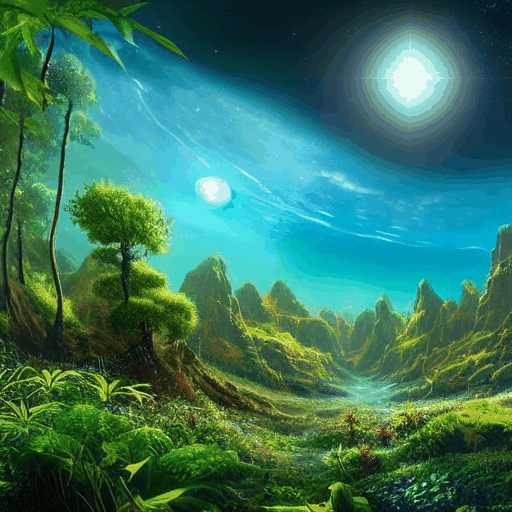

In [78]:
display_image(images, save_path)

In [79]:
# Text prompts that describes the desired output image.
prompts = [
    "A cute dog in a beautiful field of lavander colorful flowers everywhere, perfect lighting, leica summicron 35mm f2.0, kodak portra 400, film grain",
    "A cute cat in a beautiful field of lavander colorful flowers everywhere, perfect lighting, leica summicron 35mm f2.0, kodak portra 400, film grain",
]
# Negative prompts that can be used to steer the generation away from certain features.
negative_prompts = [
    "poorly drawn,cartoon, 2d, sketch, cartoon, drawing, anime, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry",
    "poorly drawn,cartoon, 2d, sketch, cartoon, drawing, anime, disfigured, bad art, deformed, poorly drawn, extra limbs, close up, b&w, weird colors, blurry",
]

# NOTE: The number of prompts must match the number of negative prompts

batch_size = len(prompts)

# Tokenizing and encoding prompts into embeddings.
prompts_tokens = pipe.tokenizer(
    prompts,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
prompts_embeds = pipe.text_encoder(prompts_tokens.input_ids.to(device))[0]

# Tokenizing and encoding negative prompts into embeddings.
if negative_prompts is None:
    negative_prompts = [""] * batch_size

negative_prompts_tokens = pipe.tokenizer(
    negative_prompts,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt",
)
negative_prompts_embeds = pipe.text_encoder(negative_prompts_tokens.input_ids.to(device))[0]

In [80]:
# Generating initial U-Net latent vectors from a random normal distribution.
latents = torch.randn(
    (1, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)

# Interpolating between embeddings pairs for the given number of interpolation steps.
interpolated_prompt_embeds = []
interpolated_negative_prompts_embeds = []
for i in range(batch_size - 1):
    interpolated_prompt_embeds.append(slerp(prompts_embeds[i], prompts_embeds[i + 1], num_interpolation_steps))
    interpolated_negative_prompts_embeds.append(
        slerp(
            negative_prompts_embeds[i],
            negative_prompts_embeds[i + 1],
            num_interpolation_steps,
        )
    )

interpolated_prompt_embeds = torch.cat(interpolated_prompt_embeds, dim=0).to(device)

interpolated_negative_prompts_embeds = torch.cat(interpolated_negative_prompts_embeds, dim=0).to(device)

100%|██████████| 30/30 [05:15<00:00, 10.51s/it]


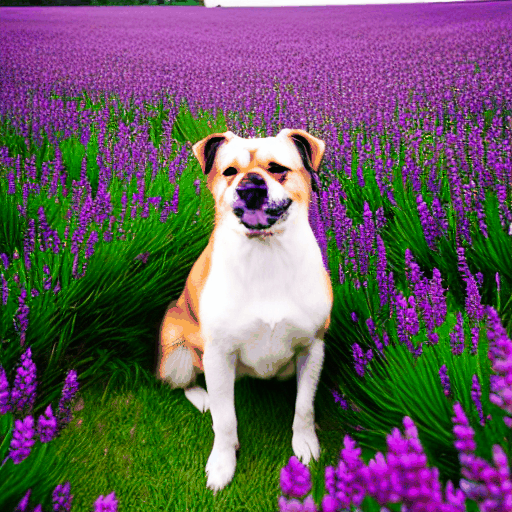

In [82]:
# Generating images using the interpolated embeddings.
images = []
for prompt_embeds, negative_prompt_embeds in tqdm(
    zip(interpolated_prompt_embeds, interpolated_negative_prompts_embeds),
    total=len(interpolated_prompt_embeds),
):
    images.append(
        pipe(
            height=height,
            width=width,
            num_images_per_prompt=1,
            prompt_embeds=prompt_embeds[None, ...],
            negative_prompt_embeds=negative_prompt_embeds[None, ...],
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latents,
        ).images
    )

# Display of saved generated images.
display_image(images, save_path)

100%|██████████| 30/30 [05:25<00:00, 10.84s/it]


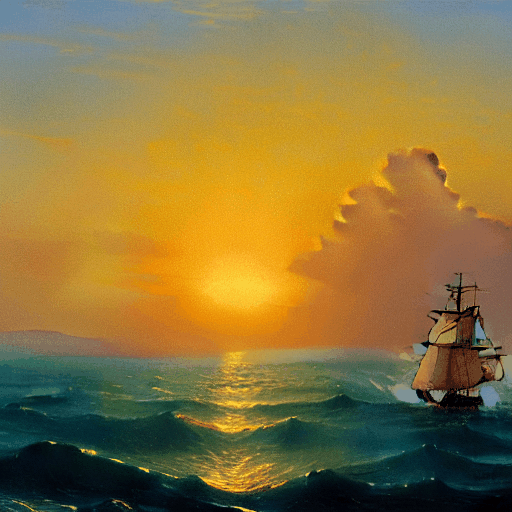

In [83]:
# The text prompt that describes the desired output image.
prompt = "Beautiful sea sunset, warm light, Aivazovsky style"
# A negative prompt that can be used to steer the generation away from certain features
negative_prompt = "picture frames"

# Generating initial latent vectors from a random normal distribution to create a loop interpolation between them.
latents = torch.randn(
    (2, 1, pipe.unet.config.in_channels, height // 8, width // 8),
    generator=generator,
)


# Calculation of looped embeddings
walk_noise_x = latents[0].to(device)
walk_noise_y = latents[1].to(device)

# Walking on a trigonometric circle
walk_scale_x = torch.cos(torch.linspace(0, 2, num_interpolation_steps) * np.pi).to(device)
walk_scale_y = torch.sin(torch.linspace(0, 2, num_interpolation_steps) * np.pi).to(device)

# Applying interpolation to noise
noise_x = torch.tensordot(walk_scale_x, walk_noise_x, dims=0)
noise_y = torch.tensordot(walk_scale_y, walk_noise_y, dims=0)

circular_latents = noise_x + noise_y

# Generating images using the interpolated embeddings.
images = []
for latent_vector in tqdm(circular_latents):
    images.append(
        pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            latents=latent_vector,
        ).images
    )

# Display of saved generated images.
display_image(images, save_path)